<h1> IMPORT DATASET AND PACKAGES </h1>

In [1]:
import pandas as pd
import numpy as np
import re
from matplotlib import pyplot as plt
plt.style.use('ggplot')
from plotly.graph_objs import Scatter
import plotly
# connected=True means it will download the latest version of plotly javascript library.
plotly.offline.init_notebook_mode(connected=True)
from plotly.graph_objs import Figure, Histogram, Layout
import plotly.graph_objects as go
import plotly.express as px
from wordcloud import WordCloud, STOPWORDS

In [2]:
data = pd.read_csv("wineFinal.csv")

In [3]:
# Read csv file
dataOriginal = pd.read_csv("wineFinal.csv") 
# Check first few 
dataOriginal.head()



,Unnamed: 0,wine_alcohol,wine_category,wine_description,wine_name,wine_origin,wine_point,wine_price,wine_variety
0,0,12.5,Red,"This is a delicious, young and vibrant wine, w...",Camille Giroud 2016 La Comme Premier Cru (San...,France,92,55,Pinot Noir
1,1,13.5,White,"A blend of Viognier, Marsanne and Roussanne, a...",Troon 2018 Côtes du Kubl White (Applegate Valley),US,92,35,Rhône-style White Blend
2,2,13.5,Red,"This is a stylish wine, showing the rich struc...",Château La Clare 2016 Médoc,France,92,29,Bordeaux-style Red Blend
3,3,14.0,Red,"Aromas of rose petal, leather and strawberry e...",Bovio 2015 Barolo,Italy,92,50,Nebbiolo
4,4,14.5,Red,"Roses, red berries and wild herbs mingle with ...",Enzo Boglietti 2015 Case Nere (Barolo),Italy,92,85,Nebbiolo


<h1> DATA CLEANING </h1>

In [4]:
# What is the index.
dataOriginal.index

RangeIndex(start=0, stop=23434, step=1)

In [5]:
# Types of column
dataOriginal.dtypes

Unnamed: 0            int64
wine_alcohol        float64
wine_category        object
wine_description     object
wine_name            object
wine_origin          object
wine_point            int64
wine_price            int64
wine_variety         object
dtype: object

In [6]:
# To check any column that has missing or NA value. 
dataOriginal.isna().any()

Unnamed: 0          False
wine_alcohol        False
wine_category       False
wine_description    False
wine_name           False
wine_origin         False
wine_point          False
wine_price          False
wine_variety        False
dtype: bool

In [7]:
# To drop missing values
dataOriginal = dataOriginal.dropna(axis=0, how='any')
# To check if missing values were taken away.
dataOriginal.isna().any()

Unnamed: 0          False
wine_alcohol        False
wine_category       False
wine_description    False
wine_name           False
wine_origin         False
wine_point          False
wine_price          False
wine_variety        False
dtype: bool

In [8]:
dataOriginal.shape

(23434, 9)

In [9]:
# Let's get only number value from wine_alcohol (take away %)
dataOriginal['wine_alcohol'] = dataOriginal.wine_alcohol.str.extract('(\d+\.?\d*)').astype(float)
dataOriginal

AttributeError: Can only use .str accessor with string values, which use np.object_ dtype in pandas

In [10]:
sum(dataOriginal.wine_alcohol > 100)

0

In [11]:
# wine alcohol can't be over 100 so get rid of those that have over 100%
dataOriginal = dataOriginal[dataOriginal.wine_alcohol < 100]
dataOriginal

,Unnamed: 0,wine_alcohol,wine_category,wine_description,wine_name,wine_origin,wine_point,wine_price,wine_variety
0,0,12.5,Red,"This is a delicious, young and vibrant wine, w...",Camille Giroud 2016 La Comme Premier Cru (San...,France,92,55,Pinot Noir
1,1,13.5,White,"A blend of Viognier, Marsanne and Roussanne, a...",Troon 2018 Côtes du Kubl White (Applegate Valley),US,92,35,Rhône-style White Blend
2,2,13.5,Red,"This is a stylish wine, showing the rich struc...",Château La Clare 2016 Médoc,France,92,29,Bordeaux-style Red Blend
3,3,14.0,Red,"Aromas of rose petal, leather and strawberry e...",Bovio 2015 Barolo,Italy,92,50,Nebbiolo
4,4,14.5,Red,"Roses, red berries and wild herbs mingle with ...",Enzo Boglietti 2015 Case Nere (Barolo),Italy,92,85,Nebbiolo
5,5,12.5,Sparkling,This limited-edition wine is a blend of grand ...,Besserat de Bellefon NV BB 1843 Cuvée Brut (C...,France,93,300,Champagne Blend
6,6,13.0,Red,This wine comes from one of the top premier cr...,Domaine Chevillon-Chezeaux 2017 Les Saint-Geor...,France,93,95,Pinot Noir
7,7,16.2,Red,Lightly herbal tones decorate the ripe red che...,Sinor-LaVallee 2016 Black Label Bassi Ranch Pi...,US,93,46,Pinot Noir
8,8,12.0,Sparkling,The wine is beautiful in its pale color and in...,Mailly Grand Cru 2011 L'Intemporelle Rosé Brut...,France,93,139,Champagne Blend
9,9,14.7,Red,This wine is made from nearly equal parts Merl...,Cami 2015 Estate Grown Red (Napa Valley),US,93,125,Bordeaux-style Red Blend


In [12]:
# Also too many countries. I want to focus only those that have significant amounts, in this case putting as 200. 
group_origin = dataOriginal.groupby('wine_origin')
grorsize = group_origin.size()
grorsize[grorsize>200]

wine_origin
Argentina        495
Australia        388
Austria          552
Chile            603
France          4650
Germany          513
Italy           3269
New Zealand      311
Portugal        1235
Spain           1076
US             10342
dtype: int64

In [13]:
#data to only those Countries with at least 200 records
data = dataOriginal.loc[dataOriginal['wine_origin'].isin(['Argentina','Australia','Austria','Chile','France','Germany','Italy','New Zealand','Portugal','Spain','US'])]
data

,Unnamed: 0,wine_alcohol,wine_category,wine_description,wine_name,wine_origin,wine_point,wine_price,wine_variety
0,0,12.5,Red,"This is a delicious, young and vibrant wine, w...",Camille Giroud 2016 La Comme Premier Cru (San...,France,92,55,Pinot Noir
1,1,13.5,White,"A blend of Viognier, Marsanne and Roussanne, a...",Troon 2018 Côtes du Kubl White (Applegate Valley),US,92,35,Rhône-style White Blend
2,2,13.5,Red,"This is a stylish wine, showing the rich struc...",Château La Clare 2016 Médoc,France,92,29,Bordeaux-style Red Blend
3,3,14.0,Red,"Aromas of rose petal, leather and strawberry e...",Bovio 2015 Barolo,Italy,92,50,Nebbiolo
4,4,14.5,Red,"Roses, red berries and wild herbs mingle with ...",Enzo Boglietti 2015 Case Nere (Barolo),Italy,92,85,Nebbiolo
5,5,12.5,Sparkling,This limited-edition wine is a blend of grand ...,Besserat de Bellefon NV BB 1843 Cuvée Brut (C...,France,93,300,Champagne Blend
6,6,13.0,Red,This wine comes from one of the top premier cr...,Domaine Chevillon-Chezeaux 2017 Les Saint-Geor...,France,93,95,Pinot Noir
7,7,16.2,Red,Lightly herbal tones decorate the ripe red che...,Sinor-LaVallee 2016 Black Label Bassi Ranch Pi...,US,93,46,Pinot Noir
8,8,12.0,Sparkling,The wine is beautiful in its pale color and in...,Mailly Grand Cru 2011 L'Intemporelle Rosé Brut...,France,93,139,Champagne Blend
9,9,14.7,Red,This wine is made from nearly equal parts Merl...,Cami 2015 Estate Grown Red (Napa Valley),US,93,125,Bordeaux-style Red Blend


In [14]:
#to write as a csv
data.to_csv('wineFinal.csv')

<h1> BASIC INFORMATION ON THIS DATA </h1>

In [15]:
data['wine_price'].mean()

38.26423145856448

In [16]:
data['wine_point'].mean()

89.23909703849108

In [17]:
data['wine_alcohol'].mean()

13.58958223094654

Red            13685
White           7150
Sparkling       1134
Rose            1133
Dessert          196
Port/Sherry      116
Fortified         20
dtype: int64


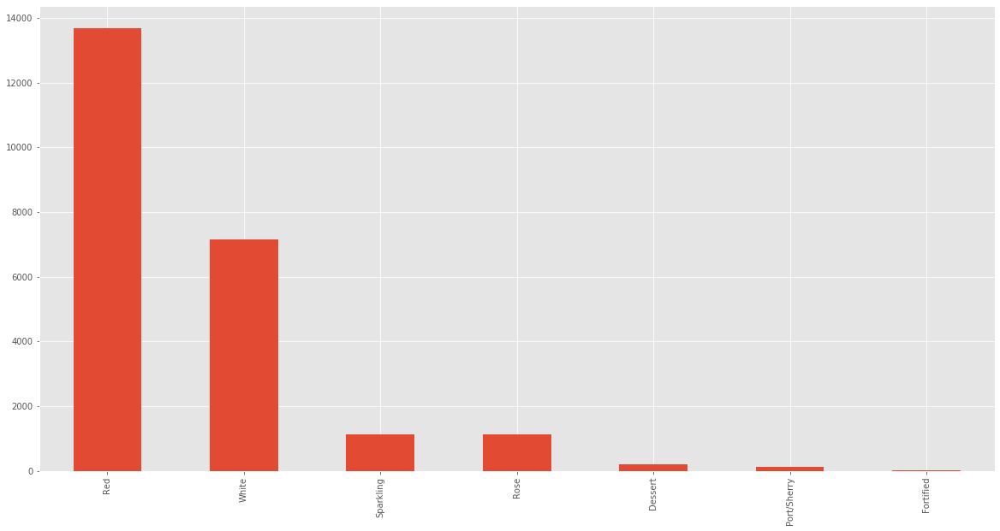

In [18]:
# What is under wine_category
count_wine_category = pd.value_counts(data['wine_category'].values, sort=True)
print(count_wine_category)

# bar graph for wine_category
count_wine_category.plot.bar(figsize = (20,10))


In [19]:
# Group by category
group_category = data.groupby('wine_category')
list(group_category)

[('Dessert',        Unnamed: 0  wine_alcohol wine_category  \
  36             38          11.5       Dessert   
  41             43          10.0       Dessert   
  47             49           8.0       Dessert   
  65             67          11.0       Dessert   
  120           122           9.0       Dessert   
  795           818          13.0       Dessert   
  1017         1046          14.5       Dessert   
  1292         1328          15.0       Dessert   
  1514         1556           7.0       Dessert   
  1517         1559           7.5       Dessert   
  1538         1580           6.5       Dessert   
  1553         1595          10.5       Dessert   
  3006         3080          14.6       Dessert   
  3588         3684          14.0       Dessert   
  3674         3771          13.5       Dessert   
  3711         3810          14.5       Dessert   
  3763         3863          10.5       Dessert   
  3770         3870          13.5       Dessert   
  3838         3941 

In [20]:
meanG_category = group_category.mean()
print(meanG_category)
medianG_category = group_category.median()
print(medianG_category)

                 Unnamed: 0  wine_alcohol  wine_point  wine_price
wine_category                                                    
Dessert        11637.882653     12.452041   90.520408   48.581633
Fortified      13195.350000     18.585000   90.050000   86.900000
Port/Sherry     8944.827586     19.254310   91.318966   57.387931
Red            12211.073365     14.030562   89.472707   44.015564
Rose           15454.913504     12.995993   87.547220   19.720212
Sparkling       8654.238095     12.031305   89.122575   42.430335
White          12734.699720     13.012066   89.007413   28.804895
               Unnamed: 0  wine_alcohol  wine_point  wine_price
wine_category                                                  
Dessert            9746.0          13.0        90.0        33.5
Fortified         14190.5          19.0        89.0        41.5
Port/Sherry        6579.0          20.0        91.0        40.0
Red               12069.0          14.0        89.0        35.0
Rose              1703

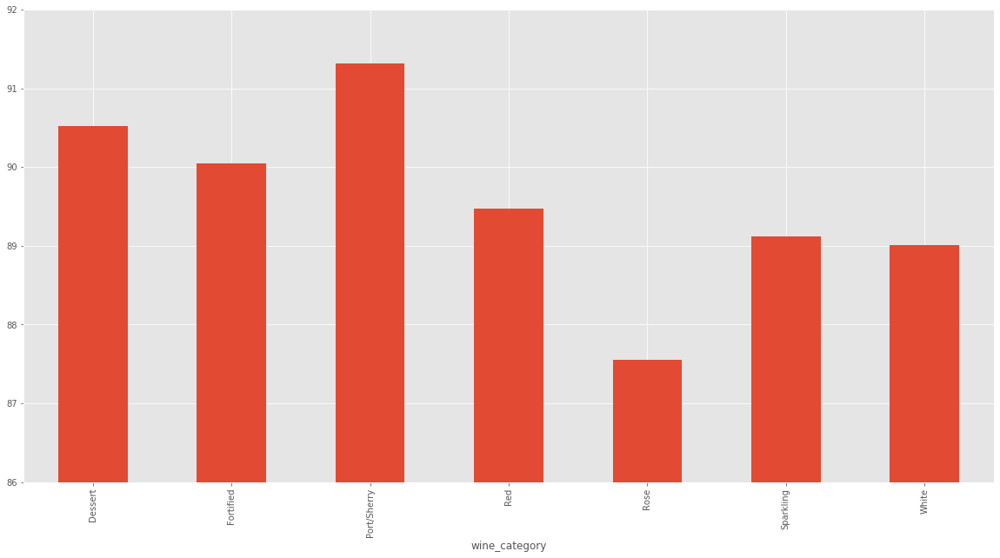

In [21]:
meanG_category['wine_point'].plot.bar(figsize = (20,10), ylim=(86,92))

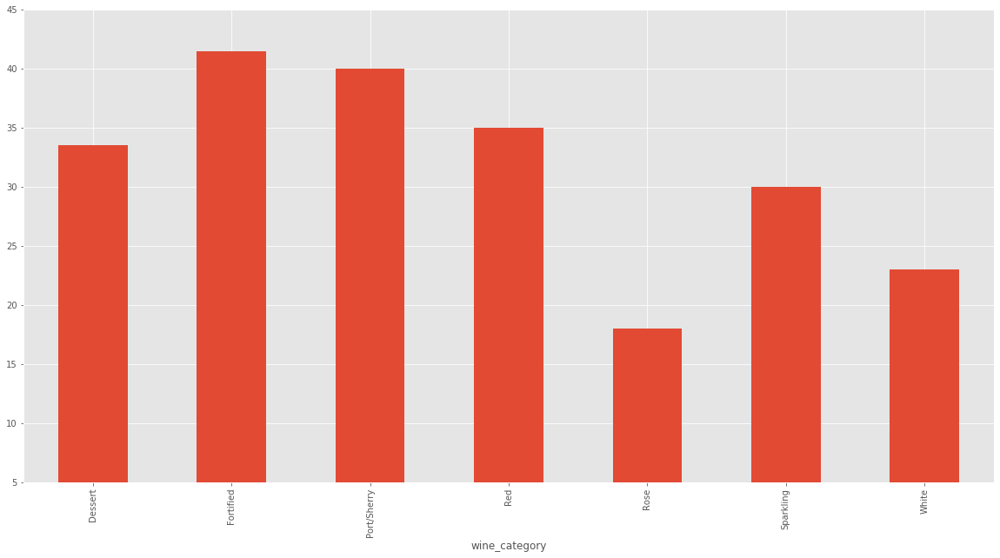

In [22]:
medianG_category['wine_price'].plot.bar(figsize = (20,10), ylim=(5,45))

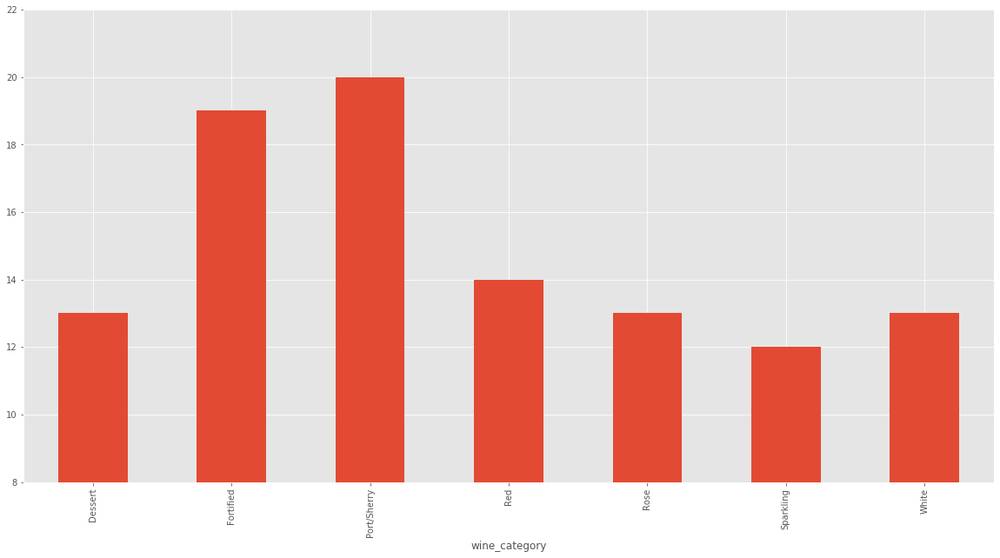

In [23]:
medianG_category['wine_alcohol'].plot.bar(figsize = (20,10), ylim = (8,22))

US             10342
France          4650
Italy           3269
Portugal        1235
Spain           1076
Chile            603
Austria          552
Germany          513
Argentina        495
Australia        388
New Zealand      311
dtype: int64


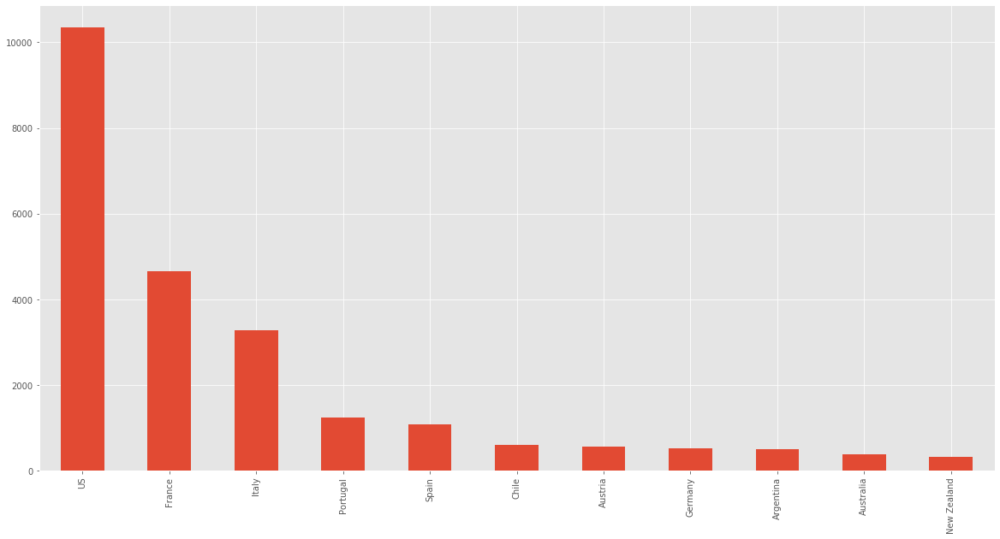

In [24]:
# What is under wine_origin
count_wine_origin = pd.value_counts(data['wine_origin'].values, sort=True)
print(count_wine_origin)

# bar graph for wine_origin
count_wine_origin.plot.bar(figsize = (20,10))

In [25]:
group_origin0 = data.groupby('wine_origin')

meanG_origin = group_origin0.mean()
print(meanG_origin)
medianG_origin = group_origin0.median()
print(medianG_origin)

               Unnamed: 0  wine_alcohol  wine_point  wine_price
wine_origin                                                    
Argentina    11051.656566     13.891313   87.600000   30.115152
Australia    12114.208763     13.763660   89.389175   43.121134
Austria      14711.523551     12.781341   91.157609   30.871377
Chile        11635.351575     13.749751   87.230514   24.431177
France       11720.759570     13.106869   89.531613   39.349462
Germany      11223.964912     10.637232   90.785575   37.867446
Italy        13082.367391     13.569746   89.191190   42.011013
New Zealand   9824.414791     13.189068   88.331190   25.305466
Portugal     13637.766802     13.884211   88.741700   26.752227
Spain        12478.268587     13.430762   87.258364   28.014870
US           12319.705956     13.965551   89.426320   40.851383
             Unnamed: 0  wine_alcohol  wine_point  wine_price
wine_origin                                                  
Argentina       12316.0          14.0       

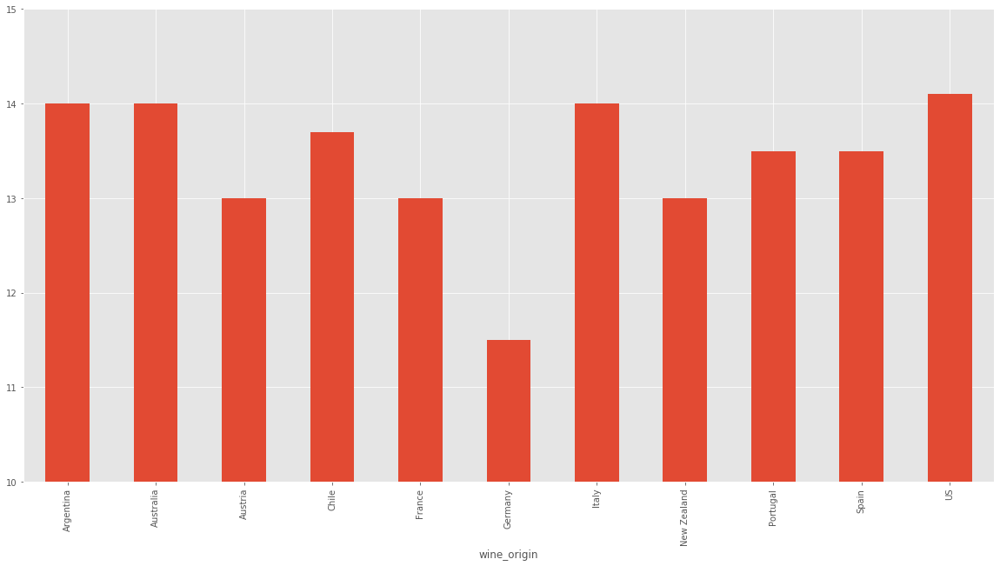

In [26]:
medianG_origin['wine_alcohol'].plot.bar(ylim=(10,15), figsize = (20,10))

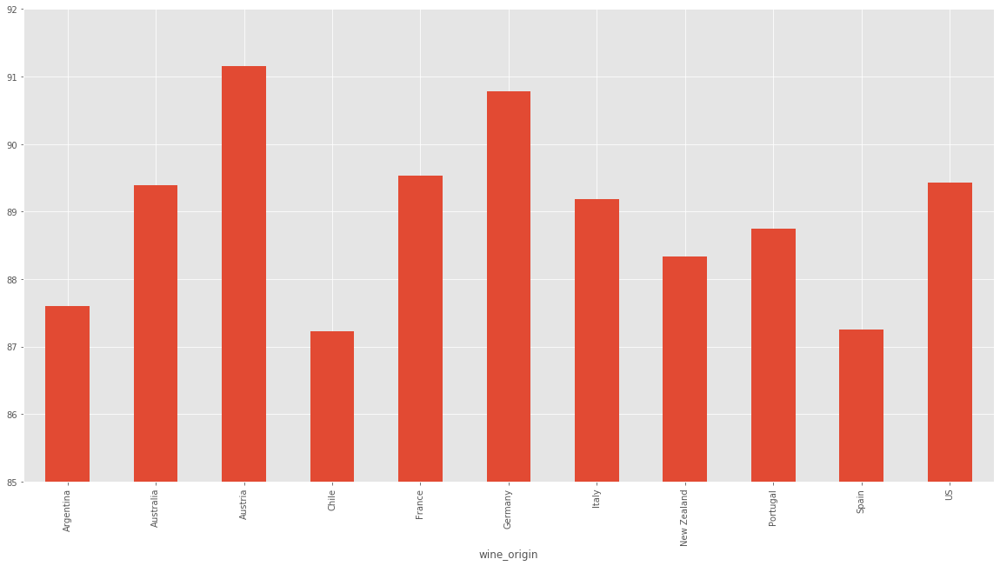

In [27]:
meanG_origin['wine_point'].plot.bar(ylim = (85,92), figsize = (20,10))

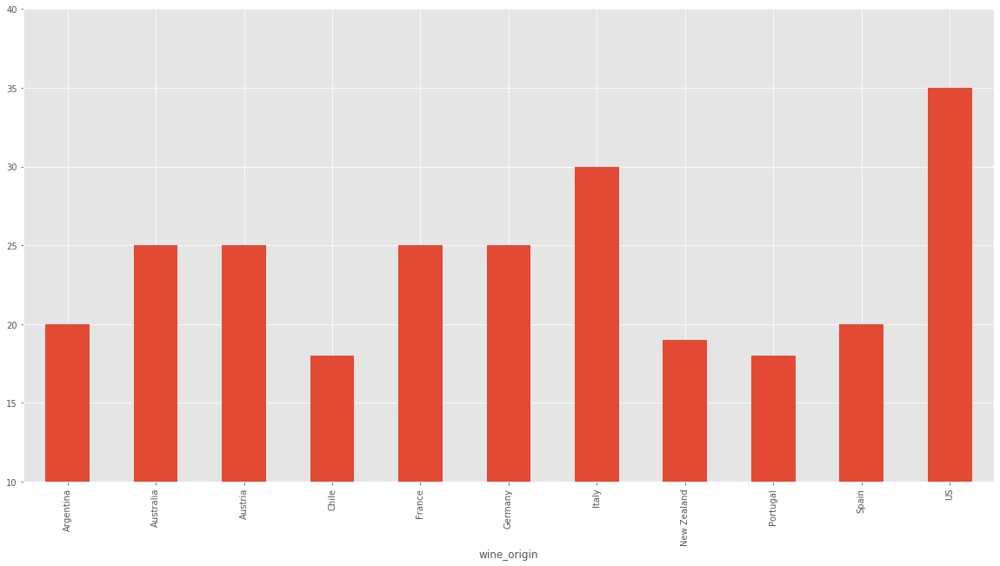

In [28]:
medianG_origin['wine_price'].plot.bar(figsize=(20,10) ,ylim = (10,40))

In [29]:
# Group by variety
group_variety = data.groupby('wine_variety')
list(group_variety)

[('Abouriou',        Unnamed: 0  wine_alcohol wine_category  \
  14614       15453          13.5           Red   
  
                                          wine_description  \
  14614  As part of Osmin's series celebrating the many...   
  
                                                 wine_name wine_origin  \
  14614  Lionel Osmin & Cie 2015 Abouriou (Côtes du Mar...      France   
  
         wine_point  wine_price wine_variety  
  14614          91          18     Abouriou  ),
 ('Aglianico',        Unnamed: 0  wine_alcohol wine_category  \
  4920         5120         14.50           Red   
  5650         6009         14.20           Red   
  7628         8120         13.50           Red   
  10558       11140         13.50           Red   
  10563       11146         14.00           Red   
  10944       11568         15.00           Red   
  13847       14665         13.88           Red   
  19306       20283         14.50           Red   
  20119       21158         12.50    

Pinot Noir                  2850
Chardonnay                  2019
Red Blends                  1483
Cabernet Sauvignon          1475
Bordeaux-style Red Blend     982
Riesling                     932
Rosé                         920
Sauvignon Blanc              876
Nebbiolo                     727
Syrah                        662
dtype: int64


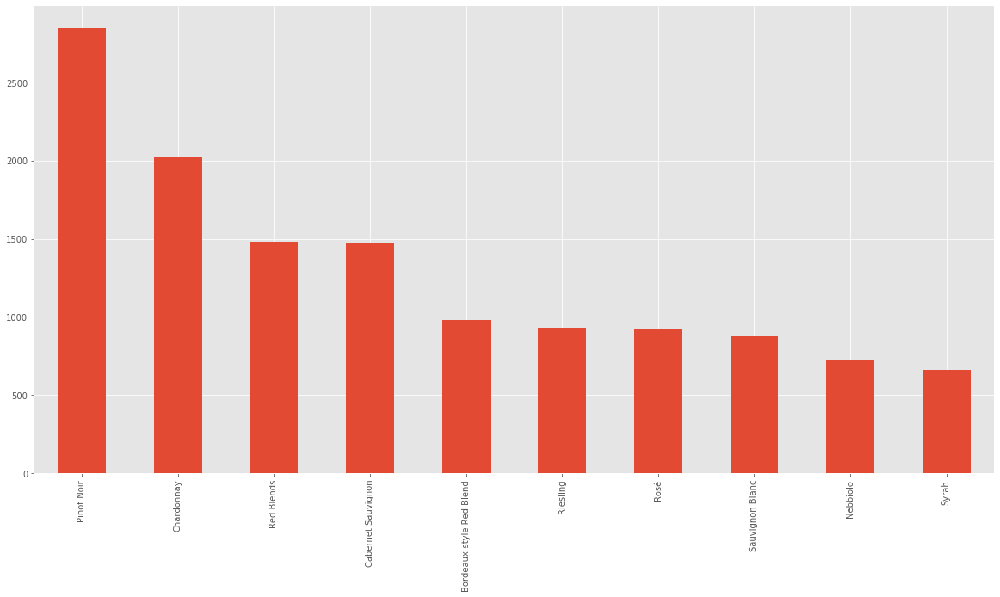

In [30]:
# What is under wine_variety
count_wine_variety = pd.value_counts(data['wine_variety'].values, sort=True)

# Only top 10 of wine_variety
top_wine_variety = count_wine_variety[:10]
print(top_wine_variety)

# bar graph for wine_variety
top_wine_variety.plot.bar(figsize = (20,10))

In [31]:
Top10 = data.loc[data['wine_variety'].isin(['Nebbiolo','Pinor Noir','Chardonnay','Bordeaux-style Red Blend',
                                    'Cabernet Sauvignon','Syrah','Red Blends',
                                    'Riesling','Rosé','Sauvignon Blanc'])]
Top10

,Unnamed: 0,wine_alcohol,wine_category,wine_description,wine_name,wine_origin,wine_point,wine_price,wine_variety
2,2,13.5,Red,"This is a stylish wine, showing the rich struc...",Château La Clare 2016 Médoc,France,92,29,Bordeaux-style Red Blend
3,3,14.0,Red,"Aromas of rose petal, leather and strawberry e...",Bovio 2015 Barolo,Italy,92,50,Nebbiolo
4,4,14.5,Red,"Roses, red berries and wild herbs mingle with ...",Enzo Boglietti 2015 Case Nere (Barolo),Italy,92,85,Nebbiolo
9,9,14.7,Red,This wine is made from nearly equal parts Merl...,Cami 2015 Estate Grown Red (Napa Valley),US,93,125,Bordeaux-style Red Blend
13,13,14.5,Red,Red berry and rose aromas mix with scents of f...,Marchesi di Barolo 2015 Sarmassa (Barolo),Italy,94,120,Nebbiolo
14,14,14.0,Red,"This offers textbook Nebbiolo aromas of rose, ...",Luigi Baudana 2015 Baudana (Barolo),Italy,95,80,Nebbiolo
15,15,13.5,Red,"This radiant, perfumed red opens with enticing...",Borgogno 2014 Cannubi (Barolo),Italy,96,164,Nebbiolo
16,16,14.0,Red,"Leather, menthol, crushed dill and celery arom...",Musso 2014 Rio Sordo (Barbaresco),Italy,88,38,Nebbiolo
22,22,13.0,White,The wine has all the warmth and ripe fruit of ...,Domaine Benoît & Mathieu Fleuriet 2015 Les Dem...,France,88,25,Sauvignon Blanc
23,23,13.0,White,The estate dates back to before the French Rev...,Domaine Girard 2016 Philippe Girard (Sancerre),France,88,26,Sauvignon Blanc


In [32]:
Top10_group_variety = Top10.groupby('wine_variety')
list(Top10_group_variety)

[('Bordeaux-style Red Blend',        Unnamed: 0  wine_alcohol wine_category  \
  2               2          13.5           Red   
  9               9          14.7           Red   
  35             37          14.2           Red   
  108           110          14.5           Red   
  126           128          14.7           Red   
  154           157          14.0           Red   
  156           159          13.0           Red   
  157           160          13.5           Red   
  172           176          14.5           Red   
  191           195          14.0           Red   
  202           206          14.7           Red   
  203           207          13.0           Red   
  271           276          13.5           Red   
  272           277          14.0           Red   
  278           283          13.5           Red   
  281           286          14.0           Red   
  285           290          14.0           Red   
  302           307          14.0           Red   
  3

In [33]:
meanGTop10_variety = Top10_group_variety.mean()
print(meanGTop10_variety)
medianGTop10_variety = Top10_group_variety.median()
print(medianGTop10_variety)

                            Unnamed: 0  wine_alcohol  wine_point  wine_price
wine_variety                                                                
Bordeaux-style Red Blend  11955.488798     13.892831   89.796334   47.251527
Cabernet Sauvignon        13105.010169     14.294231   89.047458   58.611525
Chardonnay                11583.705300     13.591734   89.400198   40.365527
Nebbiolo                  11617.643741     14.166231   90.261348   68.057772
Red Blends                11999.119353     13.980175   88.699933   33.343898
Riesling                  11492.510730     11.451781   90.738197   33.738197
Rosé                      15698.866304     12.982935   87.383696   19.207609
Sauvignon Blanc           11319.331050     13.179441   88.094749   22.792237
Syrah                     12980.264350     14.569622   90.305136   45.288520
                          Unnamed: 0  wine_alcohol  wine_point  wine_price
wine_variety                                                              
Bor

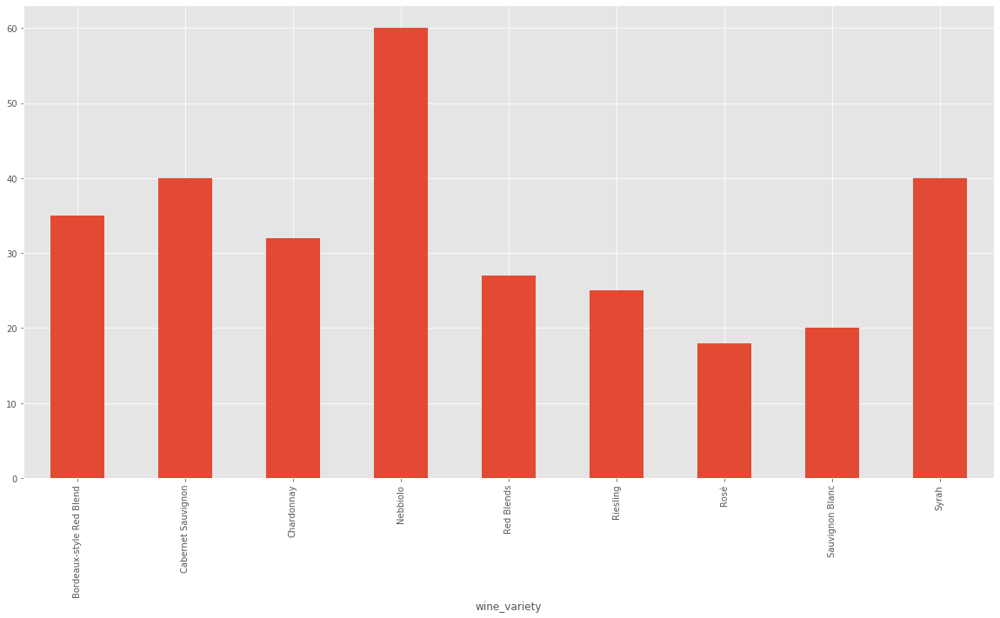

In [34]:
medianGTop10_variety['wine_price'].plot.bar(figsize=(20,10))

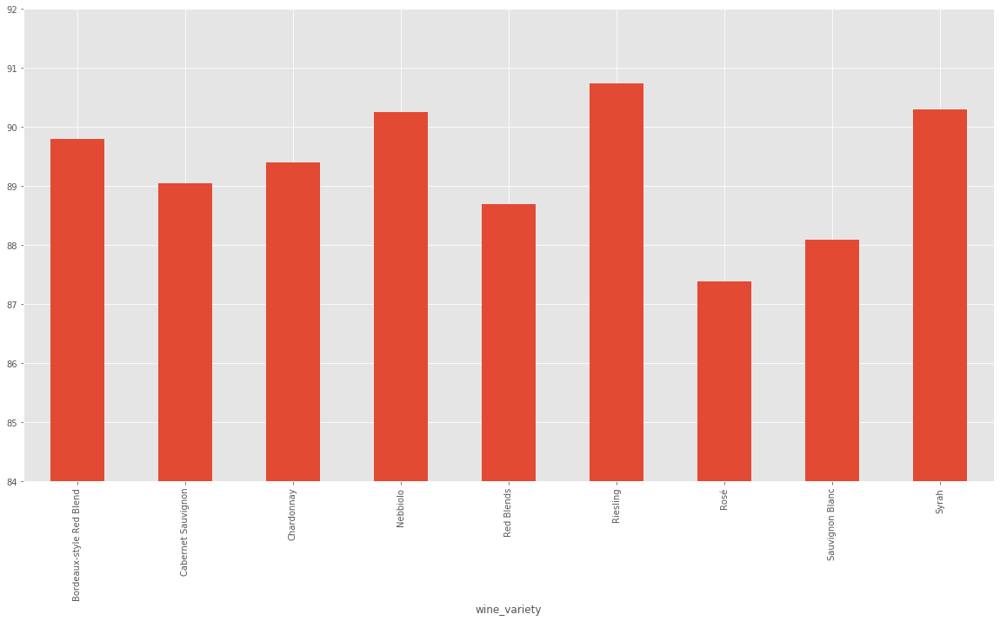

In [35]:
meanGTop10_variety['wine_point'].plot.bar(figsize=(20,10),ylim = (84,92))

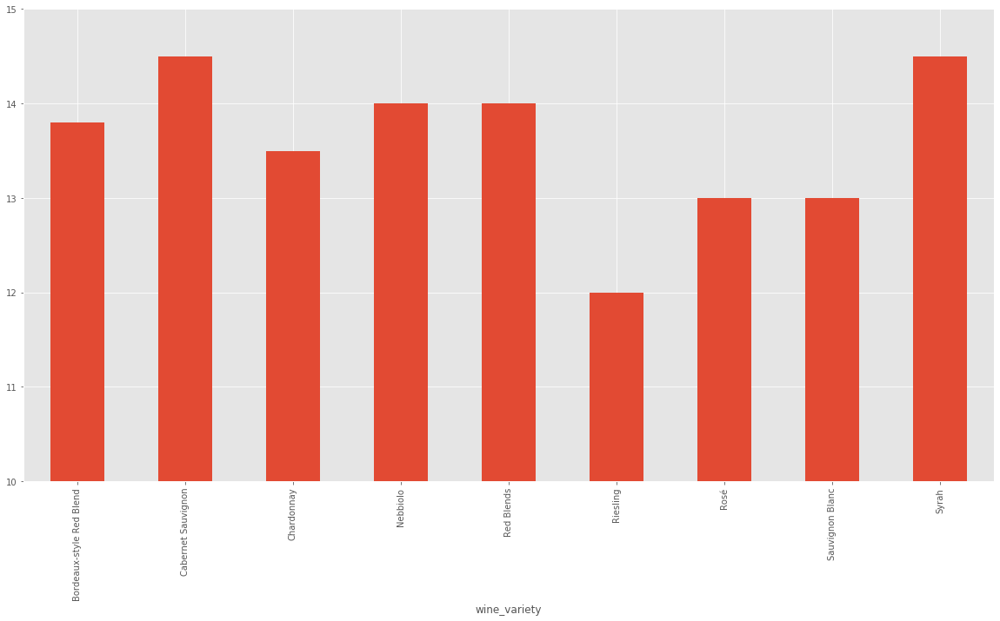

In [36]:
medianGTop10_variety['wine_alcohol'].plot.bar(figsize=(20,10), ylim=(10,15))

In [37]:
alcohol100=data.sort_values('wine_alcohol', ascending=False)[:100]
alcohol100

,Unnamed: 0,wine_alcohol,wine_category,wine_description,wine_name,wine_origin,wine_point,wine_price,wine_variety
1112,1143,95.0,Red,Ripe and thick kirsch aromas meet with a minty...,Leoness 2013 Signature Selection Syrah (Temecu...,US,92,95,Syrah
5996,6406,93.0,Red,"This smooth, rich and fine wine is maturing we...",Château Tour Grand Faurie 2009 Saint-Émilion,France,93,40,Bordeaux-style Red Blend
22098,23151,90.0,White,This elegant wine offers good balance between ...,Domaine Au Pied du Mont Chauve 2014 En Remilly...,France,90,45,Chardonnay
351,356,90.0,Red,This comes from one of the rare parcels of Syr...,Quinta da Romaneira 2014 Syrah (Duriense),Portugal,90,30,Syrah
7242,7723,90.0,Red,"Thyme-laced pomegranate juice aromas, enhanced...",Scheid 2014 Reserve Pinot Noir (Monterey),US,90,50,Pinot Noir
14021,14845,88.0,Red,"This mountain vineyard set at 2,000 feet is cu...",Companhia das Quintas 2014 Quinta do Cardo Vin...,Portugal,88,50,Portuguese Red
5591,5936,87.0,Sparkling,"This aromatic wine, floral and ripe, is made f...",Caves Transmontanas 2008 Brut Gouveio (Douro),Portugal,88,19,Gouveio
17526,18427,87.0,Rose,"Bright, crisp and fruity, this is an attractiv...",Château Rauzan Despagne 2017 Réserve Rosé (Bor...,France,87,20,Rosé
19195,20162,86.0,Rose,Sancerre rosé is always 100% Pinot Noir. In th...,Domaine des Côtes Blanches 2017 Rosé (Sancerre),France,86,27,Rosé
4933,5135,86.0,White,It's no wonder this wine is called Kaleidoscop...,Lionel Osmin & Cie 2016 San de Guilhem Kaléido...,France,86,11,White Blend


In [38]:
pd.value_counts(alcohol100['wine_category'].values, sort=True)

Port/Sherry    74
Fortified       8
Red             7
White           6
Rose            3
Sparkling       2
dtype: int64

In [39]:
pd.value_counts(alcohol100['wine_origin'].values, sort=True)

Portugal       78
France          8
Spain           6
US              5
New Zealand     1
Australia       1
Italy           1
dtype: int64

In [40]:
alcohol100['wine_price'].mean()

69.2

In [41]:
# histogram for the wine alcohol 
AlcU30 = data.loc[data['wine_alcohol']<25]
dataAlcohol = [Histogram(x=AlcU30['wine_alcohol'])]
layout = Layout(title="{Alcohol Content of Wine}",bargap=0.01)   
fig = Figure(data=dataAlcohol, layout=layout)
fig.update_xaxes(title_text='Alcohol Content (%)', nticks=20)
fig.update_yaxes(title_text='Count')
plotly.offline.iplot(fig, show_link=False, image_width=600, image_height=400)

In [42]:
point100 = data.sort_values('wine_point', ascending=False)[:100]
point100

,Unnamed: 0,wine_alcohol,wine_category,wine_description,wine_name,wine_origin,wine_point,wine_price,wine_variety
4546,4705,12.0,Sparkling,This latest incarnation of the famous brand is...,Louis Roederer 2008 Cristal Vintage Brut (Cha...,France,100,250,Champagne Blend
15394,16244,14.6,Red,This 100% Pommard clone wine from a 1990 plant...,Patricia Green Cellars 2016 Estate Vineyard Bo...,US,100,60,Pinot Noir
11876,12582,14.5,Red,This magnificent wine brings together the grea...,Château Ausone 2015 Saint-Émilion,France,100,1000,Bordeaux-style Red Blend
11875,12581,14.5,Red,"Made with 45% Cabernet Franc, this great wine ...",Château Cheval Blanc 2015 Saint-Émilion,France,100,800,Bordeaux-style Red Blend
11874,12580,13.0,Red,This is a great vintage from Lafite. The profi...,Château Lafite Rothschild 2015 Pauillac,France,100,700,Bordeaux-style Red Blend
52,54,20.5,Port/Sherry,"This is going to be a major, impressive wine. ...",Sandeman 2017 Quinta do Seixo (Port),Portugal,100,70,Port
51,53,20.0,Port/Sherry,"This is a magnificent, opulent wine, with rich...",Taylor Fladgate 2017 Vargellas Vinhas Velhas ...,Portugal,100,250,Port
50,52,12.5,Sparkling,From just over two acres of old vines in the p...,Billecart-Salmon 2002 Le Clos Saint-Hilaire Br...,France,100,500,Champagne Blend
4545,4704,12.0,Sparkling,This new release from a great vintage for Char...,Salon 2006 Le Mesnil Blanc de Blancs Brut Char...,France,100,617,Chardonnay
13398,14197,14.0,Red,"Heady scents of chopped herbs, woodland berry,...",Conti Costanti 2012 Riserva (Brunello di Mont...,Italy,100,245,Sangiovese


In [43]:
pd.value_counts(point100['wine_category'].values, sort=True)

Red            69
White          15
Sparkling       6
Dessert         6
Port/Sherry     4
dtype: int64

In [44]:
pd.value_counts(point100['wine_origin'].values, sort=True)

US          32
Italy       31
France      26
Portugal     6
Austria      3
Germany      2
dtype: int64

In [45]:
print(point100['wine_point'].mean())
print(point100['wine_point'].max())
print(point100['wine_point'].min())

97.71
100
97


In [46]:
# histogram for the wine point
dataPoint = [Histogram(x=data['wine_point'])]
layout = Layout(title="{Distribution of Points of Wine Given by Wine Enthusiast Mag}",bargap=0.01)   
fig = Figure(data=dataPoint, layout=layout)
fig.update_xaxes(title_text='Point')
fig.update_yaxes(title_text='Count')

plotly.offline.iplot(fig, show_link=False, image_width=600, image_height=400)

In [47]:
#what are top 100 expensive wines and their prices. 
price100 = data.sort_values('wine_price', ascending=False)[:100]
price100

,Unnamed: 0,wine_alcohol,wine_category,wine_description,wine_name,wine_origin,wine_point,wine_price,wine_variety
11876,12582,14.5,Red,This magnificent wine brings together the grea...,Château Ausone 2015 Saint-Émilion,France,100,1000,Bordeaux-style Red Blend
11893,12600,13.5,White,"Concentrated and with tight, mineral fruitines...",Château La Mission Haut-Brion 2015 Pessac-Léo...,France,95,992,Bordeaux-style White Blend
7958,8456,14.5,Red,Penfold's latest Grange release delivers all o...,Penfolds 2013 Grange Shiraz (South Australia),Australia,95,897,Shiraz
7873,8371,14.5,Red,From the relatively cooler climes of Eden Vall...,Henschke 2012 Hill of Grace Shiraz (Eden Valley),Australia,96,817,Shiraz
11875,12581,14.5,Red,"Made with 45% Cabernet Franc, this great wine ...",Château Cheval Blanc 2015 Saint-Émilion,France,100,800,Bordeaux-style Red Blend
1517,1559,7.5,Dessert,"With layers upon layers of spicy saffron, peac...",Robert Weil 2015 Kiedrich Gräfenberg Trockenbe...,Germany,98,775,Riesling
13113,13897,14.0,Red,"Aromas of cedar, red berry, pipe tobacco and a...",Masseto 2014 Merlot (Toscana),Italy,92,750,Merlot
11874,12580,13.0,Red,This is a great vintage from Lafite. The profi...,Château Lafite Rothschild 2015 Pauillac,France,100,700,Bordeaux-style Red Blend
11867,12573,7.0,Dessert,It's always a cliché to compare wine to the ne...,Robert Weil 2016 Kiedrich Gräfenberg Trockenbe...,Germany,97,660,Riesling
3150,3228,13.5,Red,This structured wine comes from one of the les...,Louis Latour 2015 Les Quatre Journaux (Romané...,France,95,650,Pinot Noir


In [48]:
pd.value_counts(price100['wine_category'].values, sort=True)

Red            71
Sparkling      12
White           7
Dessert         5
Port/Sherry     3
Fortified       2
dtype: int64

In [49]:
pd.value_counts(price100['wine_origin'].values, sort=True)

France       40
US           26
Italy        13
Spain         5
Portugal      5
Germany       5
Australia     4
Argentina     2
dtype: int64

In [50]:
# Plotting the wine price to see its distribution. 

dataPrice = [Histogram(x=data['wine_price'])]
layout = Layout(title="{Price of Wine}",bargap=0.01, )   
fig = Figure(data=dataPrice, layout=layout)
fig.update_xaxes(title_text='Price ($)')
fig.update_yaxes(title_text='Count')

plotly.offline.iplot(fig, show_link=False, image_width=600, image_height=400)

<h1> VARIABLES vs. PRICE </h1>

In [51]:
# wine alcohol content vs. price
dataAlcPrice = [Scatter(x=data['wine_alcohol'], y=data['wine_price'], mode = 'markers', text=data['wine_variety'])]
layout = Layout(title="Alcohol Content vs Price")

fig = Figure(data=dataAlcPrice, layout=layout)
fig.update_xaxes(title_text='Alcohol Content (%)')
fig.update_yaxes(title_text='Price ($)')

plotly.offline.iplot(fig, show_link=False)

In [52]:
# origin vs. price
dataOrgPrice = [Scatter(x=data['wine_origin'], y=data['wine_price'], mode = 'markers', text=data['wine_variety'])]
layout = Layout(title="Wine Origin by Country vs Price")

fig = Figure(data=dataOrgPrice, layout=layout)
fig.update_xaxes(title_text='Country')
fig.update_yaxes(title_text='Price ($)')

plotly.offline.iplot(fig, show_link=False)

In [53]:
# category vs. price
dataCatPrice = [Scatter(x=data['wine_category'], y=data['wine_price'], mode = 'markers', text=data['wine_name'])]
layout = Layout(title="Wine Category vs Price")

fig = Figure(data=dataCatPrice, layout=layout)
fig.update_xaxes(title_text='Category')
fig.update_yaxes(title_text='Price ($)')

plotly.offline.iplot(fig, show_link=False)

In [54]:
# variety vs. price
dataVarPrice = [Scatter(x=data['wine_variety'], y=data['wine_price'], mode = 'markers', text=data['wine_name'])]
layout = Layout(title="Wine Variety vs Price")

fig = Figure(data=dataVarPrice, layout=layout)
fig.update_xaxes(title_text='Variety')
fig.update_yaxes(title_text='Price ($)')

plotly.offline.iplot(fig, show_link=False)


dataVarPrice = [Scatter(x=Top10['wine_variety'], y=Top10['wine_price'], mode = 'markers', text=data['wine_name'])]
layout = Layout(title="Wine Top 10 Variety vs Price")

fig = Figure(data=dataVarPrice, layout=layout)
fig.update_xaxes(title_text='Variety')
fig.update_yaxes(title_text='Price ($)')

plotly.offline.iplot(fig, show_link=False)

In [55]:
# points vs. price
dataPointPrice = [Scatter(x=data['wine_point'], y=data['wine_price'], mode = 'markers', text=data['wine_name'])]
layout = Layout(title="Wine Point vs Price")

fig = Figure(data=dataPointPrice, layout=layout)
fig.update_xaxes(title_text='Point')
fig.update_yaxes(title_text='Price ($)')

plotly.offline.iplot(fig, show_link=False)

<h1> WHAT EACH COUNTRY PRODUCE? </h1>

In [56]:
data['wine_origin'].unique()

array(['France', 'US', 'Italy', 'Argentina', 'Portugal', 'Austria',
       'Australia', 'New Zealand', 'Germany', 'Chile', 'Spain'],
      dtype=object)

In [57]:
#Italy
OriItaly = data.loc[data['wine_origin'] =='Italy']
OriItaly

,Unnamed: 0,wine_alcohol,wine_category,wine_description,wine_name,wine_origin,wine_point,wine_price,wine_variety
3,3,14.0,Red,"Aromas of rose petal, leather and strawberry e...",Bovio 2015 Barolo,Italy,92,50,Nebbiolo
4,4,14.5,Red,"Roses, red berries and wild herbs mingle with ...",Enzo Boglietti 2015 Case Nere (Barolo),Italy,92,85,Nebbiolo
13,13,14.5,Red,Red berry and rose aromas mix with scents of f...,Marchesi di Barolo 2015 Sarmassa (Barolo),Italy,94,120,Nebbiolo
14,14,14.0,Red,"This offers textbook Nebbiolo aromas of rose, ...",Luigi Baudana 2015 Baudana (Barolo),Italy,95,80,Nebbiolo
15,15,13.5,Red,"This radiant, perfumed red opens with enticing...",Borgogno 2014 Cannubi (Barolo),Italy,96,164,Nebbiolo
16,16,14.0,Red,"Leather, menthol, crushed dill and celery arom...",Musso 2014 Rio Sordo (Barbaresco),Italy,88,38,Nebbiolo
17,17,13.5,Red,"Ripe black plum, leather and Mediterranean scr...",Patria 2013 Stella di Corleone Nero d'Avola (S...,Italy,88,24,Nero d'Avola
19,19,14.0,Red,"The nose opens with black-skinned berry, under...",Feudo Principi di Butera 2015 Nero d'Avola (Si...,Italy,88,17,Nero d'Avola
28,29,14.0,Red,This organically farmed Nero d'Avola opens wit...,Alessandro di Camporeale 2015 Donnatà Nero d'A...,Italy,88,16,Nero d'Avola
33,34,14.0,Red,"Made entirely from Syrah, this has mature blac...",Alessandro di Camporeale 2015 Kaid Syrah (Sici...,Italy,88,30,Syrah


In [58]:
# Italy variety
count_OriItaly = pd.value_counts(OriItaly['wine_variety'].values, sort=True)

# Only top 10 of Italy
top_OriItaly = count_OriItaly[:10]
print(top_OriItaly)



Nebbiolo           717
Red Blends         627
Sangiovese         416
Barbera            201
Glera              182
White Blend        122
Pinot Grigio        69
Sparkling Blend     65
Nero d'Avola        61
Verdicchio          51
dtype: int64


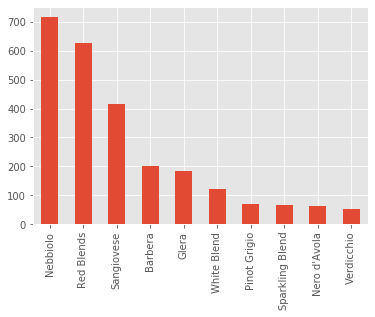

In [59]:
#dataOriItaly = [Histogram(x=top_OriItaly['wine_variety'])]
#layout = Layout(title="Different Varieties of Wine Produced From Italy")

top_OriItaly.plot.bar()

#fig = Figure(data=dataOriItaly, layout=layout)
#fig.update_xaxes(title_text='Variety')
#fig.update_yaxes(title_text='Count')

#plotly.offline.iplot(fig, show_link=False)

In [60]:
#France
OriFrance = data.loc[data['wine_origin'] =='France']
OriFrance


,Unnamed: 0,wine_alcohol,wine_category,wine_description,wine_name,wine_origin,wine_point,wine_price,wine_variety
0,0,12.5,Red,"This is a delicious, young and vibrant wine, w...",Camille Giroud 2016 La Comme Premier Cru (San...,France,92,55,Pinot Noir
2,2,13.5,Red,"This is a stylish wine, showing the rich struc...",Château La Clare 2016 Médoc,France,92,29,Bordeaux-style Red Blend
5,5,12.5,Sparkling,This limited-edition wine is a blend of grand ...,Besserat de Bellefon NV BB 1843 Cuvée Brut (C...,France,93,300,Champagne Blend
6,6,13.0,Red,This wine comes from one of the top premier cr...,Domaine Chevillon-Chezeaux 2017 Les Saint-Geor...,France,93,95,Pinot Noir
8,8,12.0,Sparkling,The wine is beautiful in its pale color and in...,Mailly Grand Cru 2011 L'Intemporelle Rosé Brut...,France,93,139,Champagne Blend
10,10,12.5,Sparkling,"This palest of rosés is ethereal, with a light...",Billecart-Salmon 2007 Cuvée Elisabeth Rosé Bru...,France,94,245,Champagne Blend
11,11,12.0,Sparkling,Extra bottle age has allowed this wine to deve...,Liebart-Régnier 2014 Excélia Brut (Champagne),France,94,60,Champagne Blend
12,12,13.0,Red,In the heart of the massive run of premier cru...,Albert Morot 2017 Teurons Premier Cru (Beaune),France,94,55,Pinot Noir
21,21,12.5,Red,This warm ripe blend of Pinot Noir and Gamay h...,Florian Roblin 2015 Champ Gibault Pinot Noir-G...,France,88,35,Pinot Noir-Gamay
22,22,13.0,White,The wine has all the warmth and ripe fruit of ...,Domaine Benoît & Mathieu Fleuriet 2015 Les Dem...,France,88,25,Sauvignon Blanc


Bordeaux-style Red Blend      604
Chardonnay                    581
Pinot Noir                    492
Rosé                          415
Gamay                         340
Champagne Blend               228
Rhône-style Red Blend         203
Sauvignon Blanc               201
Riesling                      158
Bordeaux-style White Blend    147
dtype: int64


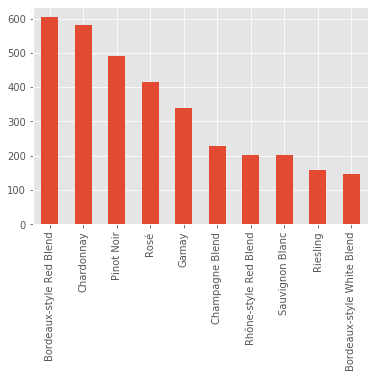

In [61]:
# France variety
count_OriFrance = pd.value_counts(OriFrance['wine_variety'].values, sort=True)

# Only top 10 of France
top_OriFrance = count_OriFrance[:10]
print(top_OriFrance)

top_OriFrance.plot.bar()

#dataOriFrance = [Histogram(x=OriFrance['wine_variety'])]
#layout = Layout(title="Different Varieties of Wine Produced From France")

#fig = Figure(data=dataOriFrance, layout=layout)
#fig.update_xaxes(title_text='Variety')
#fig.update_yaxes(title_text='Count')

#plotly.offline.iplot(fig, show_link=False)

Pinot Noir                  2122
Chardonnay                  1223
Cabernet Sauvignon          1205
Red Blends                   562
Syrah                        538
Zinfandel                    428
Sauvignon Blanc              399
Bordeaux-style Red Blend     342
Rosé                         331
Merlot                       309
dtype: int64


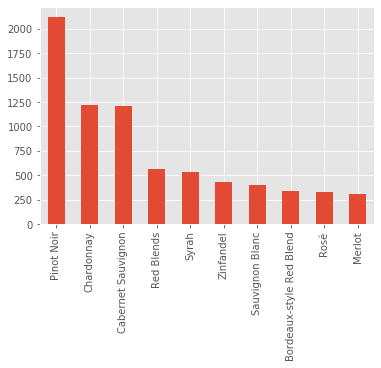

In [62]:
#US
OriUS = data.loc[data['wine_origin'] =='US']
OriUS
#dataOriUS = [Histogram(x=OriUS['wine_variety'])]
#layout = Layout(title="Different Varieties of Wine Produced From US")

#fig = Figure(data=dataOriUS, layout=layout)
#fig.update_xaxes(title_text='Variety')
#fig.update_yaxes(title_text='Count')

#plotly.offline.iplot(fig, show_link=False)

# US variety
count_OriUS = pd.value_counts(OriUS['wine_variety'].values, sort=True)

# Only top 10 of Italy
top_OriUS = count_OriUS[:10]
print(top_OriUS)

top_OriUS.plot.bar()

Shiraz                      118
Cabernet Sauvignon           65
Chardonnay                   53
Riesling                     29
Pinot Noir                   17
Grenache                     16
Rosé                         11
Sauvignon Blanc-Semillon      7
Red Blends                    6
Pinot Grigio                  6
dtype: int64


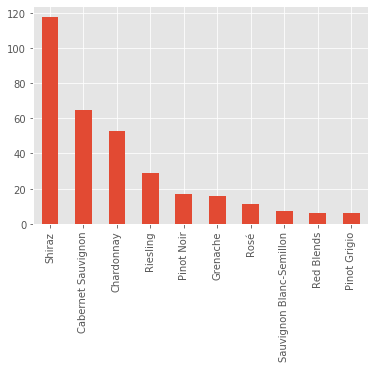

In [63]:
#Australia
OriAustralia = data.loc[data['wine_origin'] =='Australia']
OriAustralia
#dataOriAustralia = [Histogram(x=OriAustralia['wine_variety'])]
#layout = Layout(title="Different Varieties of Wine Produced From Australia")

#fig = Figure(data=dataOriAustralia, layout=layout)
#fig.update_xaxes(title_text='Variety')
#fig.update_yaxes(title_text='Count')
#plotly.offline.iplot(fig, show_link=False)

# Australia variety
count_OriAustralia = pd.value_counts(OriAustralia['wine_variety'].values, sort=True)

# Only top 10 of Australia
top_OriAustralia = count_OriAustralia[:10]
print(top_OriAustralia)

top_OriAustralia.plot.bar()

Malbec                       211
Cabernet Sauvignon            69
Red Blends                    42
Chardonnay                    36
Bordeaux-style Red Blend      20
Cabernet Franc                18
Torrontés                     17
Bonarda                       10
Rosé                           9
Malbec-Cabernet Sauvignon      8
dtype: int64


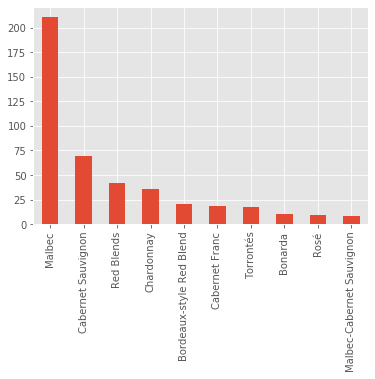

In [64]:
#Argentina
OriArgentina = data.loc[data['wine_origin'] =='Argentina']
OriArgentina
#dataOriArgentina = [Histogram(x=OriArgentina['wine_variety'])]
#layout = Layout(title="Different Varieties of Wine Produced From Argentina")
#fig = Figure(data=dataOriArgentina, layout=layout)
#fig.update_xaxes(title_text='Variety')
#fig.update_yaxes(title_text='Count')
#plotly.offline.iplot(fig, show_link=False)

# Argentina variety
count_OriArgentina = pd.value_counts(OriArgentina['wine_variety'].values, sort=True)

# Only top 10 of Argentina
top_OriArgentina = count_OriArgentina[:10]
print(top_OriArgentina)

top_OriArgentina.plot.bar()

Tempranillo          207
Sparkling Blend      139
Red Blends            84
Tempranillo Blend     65
Albariño              63
White Blend           61
Garnacha              61
Verdejo               54
Rosé                  32
Monastrell            25
dtype: int64


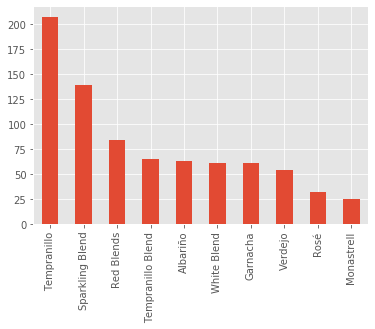

In [65]:
#Spain
OriSpain = data.loc[data['wine_origin'] =='Spain']
OriSpain
#dataOriSpain = [Histogram(x=OriSpain['wine_variety'])]
#layout = Layout(title="Different Varieties of Wine Produced From Spain")

#fig = Figure(data=dataOriSpain, layout=layout)
#fig.update_xaxes(title_text='Variety')
#fig.update_yaxes(title_text='Count')

#plotly.offline.iplot(fig, show_link=False)

# Spain variety
count_OriSpain = pd.value_counts(OriSpain['wine_variety'].values, sort=True)

# Only top 10 of Spain
top_OriSpain = count_OriSpain[:10]
print(top_OriSpain)

top_OriSpain.plot.bar()

Cabernet Sauvignon    108
Red Blends             90
Carmenère              80
Sauvignon Blanc        77
Pinot Noir             67
Chardonnay             35
Syrah                  31
Malbec                 20
Merlot                 13
Rosé                   11
dtype: int64


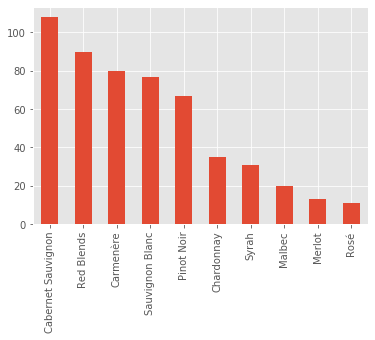

In [66]:
#Chile
OriChile = data.loc[data['wine_origin'] =='Chile']
OriChile

count_OriChile = pd.value_counts(OriChile['wine_variety'].values, sort=True)

top_OriChile = count_OriChile[:10]
print(top_OriChile)

top_OriChile.plot.bar()

Grüner Veltliner        227
Riesling                101
Blaufränkisch            37
Zweigelt                 34
Pinot Noir               20
Rosé                     18
Sparkling Blend          15
Sauvignon Blanc          13
Austrian white blend     13
Red Blends               10
dtype: int64


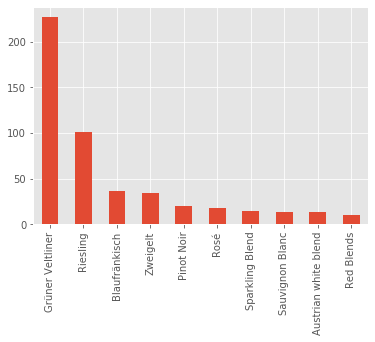

In [67]:
#Austria
OriAustria = data.loc[data['wine_origin'] =='Austria']
OriAustria
#dataOriAustria = [Histogram(x=OriAustria['wine_variety'])]
#layout = Layout(title="Different Varieties of Wine Produced From Austria")

#fig = Figure(data=dataOriAustria, layout=layout)
#fig.update_xaxes(title_text='Variety')
#fig.update_yaxes(title_text='Count')

#plotly.offline.iplot(fig, show_link=False)

# Austria variety
count_OriAustria = pd.value_counts(OriAustria['wine_variety'].values, sort=True)

# Only top 10 of Austria
top_OriAustria = count_OriAustria[:10]
print(top_OriAustria)

top_OriAustria.plot.bar()

Portuguese Red       550
Portuguese White     276
Port                  81
Rosé                  71
Alvarinho             38
Touriga Nacional      36
Arinto                20
Encruzado             13
Syrah                 12
Alicante Bouschet     11
dtype: int64


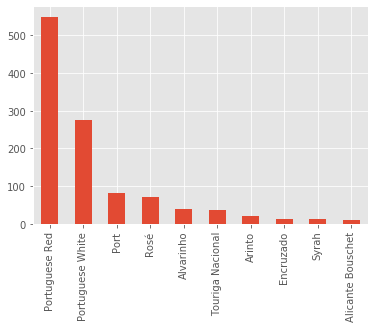

In [68]:
#Portugal
OriPortugal = data.loc[data['wine_origin'] =='Portugal']
OriPortugal
#dataOriPortugal = [Histogram(x=OriPortugal['wine_variety'])]
#layout = Layout(title="Different Varieties of Wine Produced From Portugal")

#fig = Figure(data=dataOriPortugal, layout=layout)
#fig.update_xaxes(title_text='Variety')
#fig.update_yaxes(title_text='Count')

#plotly.offline.iplot(fig, show_link=False)

# Portugal variety
count_OriPortugal = pd.value_counts(OriPortugal['wine_variety'].values, sort=True)

# Only top 10 of Portugal
top_OriPortugal = count_OriPortugal[:10]
print(top_OriPortugal)

top_OriPortugal.plot.bar()

In [69]:
data['wine_category'].unique()


array(['Red', 'White', 'Sparkling', 'Dessert', 'Port/Sherry', 'Rose',
       'Fortified'], dtype=object)

In [70]:
#'Sparkling', 'Dessert', 'Rose', 'Port/Sherry']

Red_data = data.loc[data.wine_category=='Red']['wine_origin']
White_data = data.loc[data.wine_category=='White']['wine_origin']
Sparkling_data = data.loc[data.wine_category=='Sparkling']['wine_origin']
Dessert_data = data.loc[data.wine_category=='Dessert']['wine_origin']
Rose_data = data.loc[data.wine_category=='Rose']['wine_origin']
Port_data = data.loc[data.wine_category=='Port/Sherry']['wine_origin']
Fortified_data = data.loc[data.wine_category == 'Fortified']['wine_origin']

#getbins = lambda t:{'start':t.min(),'end':t.max(), 'size':0.5}

trace0 = Histogram(x=Red_data,name='Red')

trace1 = Histogram(x=White_data,name='White')

trace2 = Histogram(x=Sparkling_data, name = 'Sparkling')

trace3 = Histogram(x=Dessert_data, name = 'Dessert')

trace4 = Histogram(x=Rose_data, name = 'Rose')

trace5 = Histogram(x=Port_data, name = 'Port/Sherry')

trace6 = Histogram(x=Fortified_data, name = 'Fortified')

dataStacked = [trace0, trace1, trace2, trace3, trace4, trace5, trace6]   
# this is how we use different bars to graph together. -> for plotly, need to manually split the dataset

layout = Layout(title="Wine Production by Country",
               bargroupgap=0.1)
fig = Figure(data=dataStacked, layout=layout)

plotly.offline.iplot(fig, show_link=False, image_width=600, image_height=400)


<h1> WordCloud </h1>

In [71]:
#stopwords
stopwords = set(STOPWORDS)
stopwords.update(["drink", "now", "wine", "flavor", "flavors", "aroma", "aromas", "finish", "note", "show", "notes"])

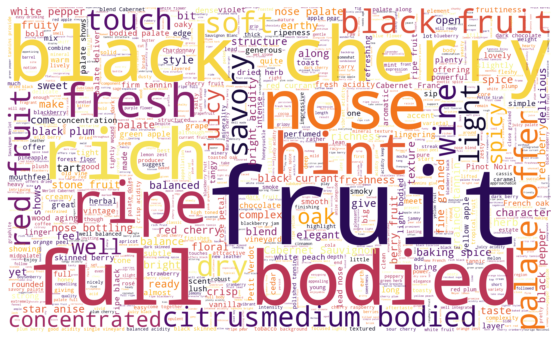

In [72]:
#WordCloud for all wines
wc = WordCloud(stopwords=stopwords,background_color="white", max_words=2000, width=1000, height=600,colormap = plt.cm.inferno, scale = 2.0)
wc.generate(' '.join(data['wine_description']))
plt.figure(figsize=(12, 6))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

<h3> WordCloud for each category </h3>

In [73]:
RedWC = data[data['wine_category'] == 'Red']
RedWC

,Unnamed: 0,wine_alcohol,wine_category,wine_description,wine_name,wine_origin,wine_point,wine_price,wine_variety
0,0,12.5,Red,"This is a delicious, young and vibrant wine, w...",Camille Giroud 2016 La Comme Premier Cru (San...,France,92,55,Pinot Noir
2,2,13.5,Red,"This is a stylish wine, showing the rich struc...",Château La Clare 2016 Médoc,France,92,29,Bordeaux-style Red Blend
3,3,14.0,Red,"Aromas of rose petal, leather and strawberry e...",Bovio 2015 Barolo,Italy,92,50,Nebbiolo
4,4,14.5,Red,"Roses, red berries and wild herbs mingle with ...",Enzo Boglietti 2015 Case Nere (Barolo),Italy,92,85,Nebbiolo
6,6,13.0,Red,This wine comes from one of the top premier cr...,Domaine Chevillon-Chezeaux 2017 Les Saint-Geor...,France,93,95,Pinot Noir
7,7,16.2,Red,Lightly herbal tones decorate the ripe red che...,Sinor-LaVallee 2016 Black Label Bassi Ranch Pi...,US,93,46,Pinot Noir
9,9,14.7,Red,This wine is made from nearly equal parts Merl...,Cami 2015 Estate Grown Red (Napa Valley),US,93,125,Bordeaux-style Red Blend
12,12,13.0,Red,In the heart of the massive run of premier cru...,Albert Morot 2017 Teurons Premier Cru (Beaune),France,94,55,Pinot Noir
13,13,14.5,Red,Red berry and rose aromas mix with scents of f...,Marchesi di Barolo 2015 Sarmassa (Barolo),Italy,94,120,Nebbiolo
14,14,14.0,Red,"This offers textbook Nebbiolo aromas of rose, ...",Luigi Baudana 2015 Baudana (Barolo),Italy,95,80,Nebbiolo


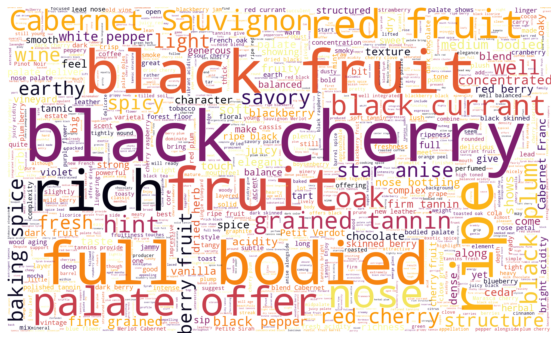

In [74]:
#WordCloud for Red
wc = WordCloud(stopwords=stopwords,background_color="white", max_words=2000, width=1000, height=600,colormap = plt.cm.inferno, scale = 2.0)
wc.generate(' '.join(RedWC['wine_description']))
plt.figure(figsize=(12, 6))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

In [75]:
WhiteWC = data[data['wine_category'] == 'White']
WhiteWC

,Unnamed: 0,wine_alcohol,wine_category,wine_description,wine_name,wine_origin,wine_point,wine_price,wine_variety
1,1,13.50,White,"A blend of Viognier, Marsanne and Roussanne, a...",Troon 2018 Côtes du Kubl White (Applegate Valley),US,92,35,Rhône-style White Blend
22,22,13.00,White,The wine has all the warmth and ripe fruit of ...,Domaine Benoît & Mathieu Fleuriet 2015 Les Dem...,France,88,25,Sauvignon Blanc
23,23,13.00,White,The estate dates back to before the French Rev...,Domaine Girard 2016 Philippe Girard (Sancerre),France,88,26,Sauvignon Blanc
24,25,14.10,White,Barrel fermentation helps round out the flavor...,Aubichon Cellars 2015 Chardonnay (Willamette V...,US,88,35,Chardonnay
26,27,12.50,White,"Lightly oaked and honest throughout, this Char...",Alfredo Roca 2016 Dedicatión Personal Chardonnay,Argentina,88,18,Chardonnay
29,30,11.40,White,This off-dry wine balances its 33 g/L of resid...,Abacela 2016 Muscat (Umpqua Valley),US,88,18,Muscat
32,33,13.00,White,This lightly wood-aged wine is soft and round ...,Casa Cadaval 2015 Vinha Padre Pedro Reserva Vi...,Portugal,88,18,Portuguese White
34,35,12.80,White,"This pale-colored, dry and light-bodied wine c...",Navarro 2016 Cuvée 128 Sauvignon Blanc (Anders...,US,88,19,Sauvignon Blanc
66,68,13.00,White,"Extremely delicate and pure aromas of lemon, n...",Chanin 2017 Bien Nacido Vineyard Chardonnay (S...,US,96,39,Chardonnay
74,76,13.50,White,This wine has both power and wonderful fruit. ...,Vincent Girardin 2016 Corton-Charlemagne,France,95,239,Chardonnay


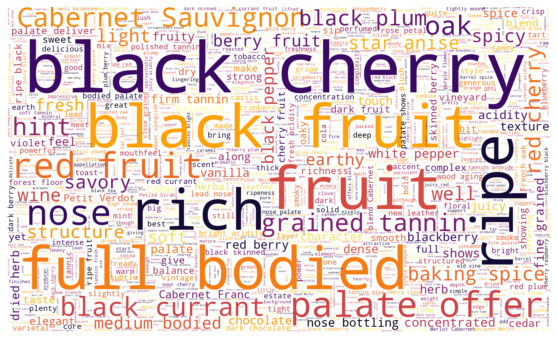

In [76]:
#WordCloud for White
wc = WordCloud(stopwords=stopwords,background_color="white", max_words=2000, width=1000, height=600,colormap = plt.cm.inferno, scale = 2.0)
wc.generate(' '.join(RedWC['wine_description']))
plt.figure(figsize=(12, 6))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

In [77]:
SparklingWC = data[data['wine_category'] == 'Sparkling']
SparklingWC

,Unnamed: 0,wine_alcohol,wine_category,wine_description,wine_name,wine_origin,wine_point,wine_price,wine_variety
5,5,12.5,Sparkling,This limited-edition wine is a blend of grand ...,Besserat de Bellefon NV BB 1843 Cuvée Brut (C...,France,93,300,Champagne Blend
8,8,12.0,Sparkling,The wine is beautiful in its pale color and in...,Mailly Grand Cru 2011 L'Intemporelle Rosé Brut...,France,93,139,Champagne Blend
10,10,12.5,Sparkling,"This palest of rosés is ethereal, with a light...",Billecart-Salmon 2007 Cuvée Elisabeth Rosé Bru...,France,94,245,Champagne Blend
11,11,12.0,Sparkling,Extra bottle age has allowed this wine to deve...,Liebart-Régnier 2014 Excélia Brut (Champagne),France,94,60,Champagne Blend
37,39,12.0,Sparkling,"While still young, this Champagne has all the ...",Laurent-Perrier 2008 Millésimé Brut (Champagne),France,96,80,Champagne Blend
48,50,12.0,Sparkling,The wine's name stands for recently disgorged ...,Bollinger 2004 R.D. Extra Brut (Champagne),France,98,300,Champagne Blend
50,52,12.5,Sparkling,From just over two acres of old vines in the p...,Billecart-Salmon 2002 Le Clos Saint-Hilaire Br...,France,100,500,Champagne Blend
78,80,12.5,Sparkling,The iconic Belle Epoque bottle reveals a well-...,Perrier Jouët 2012 Belle Epoque Brut (Champagne),France,95,155,Champagne Blend
79,81,12.0,Sparkling,Produced from the six grand cru vineyards belo...,G. H. Mumm NV RSRV Maison Mumm Rosé Foujita Br...,France,95,75,Champagne Blend
80,82,12.5,Sparkling,"With 50% vinification in oak, this Champagne h...",Billecart-Salmon 2007 Cuvée Louis Salmon Brut ...,France,95,180,Champagne Blend


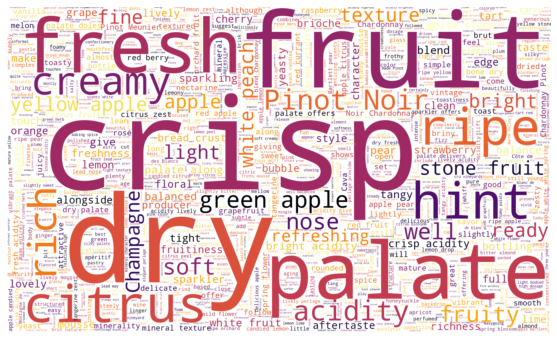

In [78]:
#WordCloud for Sparkling
wc = WordCloud(stopwords=stopwords,background_color="white", max_words=2000, width=1000, height=600,colormap = plt.cm.inferno, scale = 2.0)
wc.generate(' '.join(SparklingWC['wine_description']))
plt.figure(figsize=(12, 6))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

In [79]:
DessertWC = data[data['wine_category'] == 'Dessert']
DessertWC

,Unnamed: 0,wine_alcohol,wine_category,wine_description,wine_name,wine_origin,wine_point,wine_price,wine_variety
36,38,11.5,Dessert,Caramel and toffee on the nose join the musky ...,Steindorfer 2015 Cuvée Klaus Beerenauslese Whi...,Austria,96,30,Austrian white blend
41,43,10.0,Dessert,"Golden blossom honey, musky botrytis and candi...",Kracher 2017 Nouvelle Vague Nummer 3 Trockenbe...,Austria,97,120,Austrian white blend
47,49,8.0,Dessert,Vivid notes of plum tart and cinnamon play on ...,Kracher 2017 Beerenauslese Zweigelt (Burgenland),Austria,97,45,Zweigelt
65,67,11.0,Dessert,"Musky botrytis and zesty, candied grapefruit p...",Höpler 2017 Trockenbeerenauslese White (Burgen...,Austria,96,49,Austrian white blend
120,122,9.0,Dessert,A relatively light and delightful dessert wine...,Trisaetum 2018 Lassa Late Harvest Riesling (Wi...,US,94,42,Riesling
795,818,13.0,Dessert,This late-harvest wine has hints of honeyed bo...,Global Wines 2012 Outono de Santar White (Dão),Portugal,90,16,Portuguese White
1017,1046,14.5,Dessert,"Made from 100% dried Zibibbo grapes, this clas...",Donnafugata 2014 Ben Ryé (Passito di Pantelle...,Italy,93,39,Zibibbo
1292,1328,15.0,Dessert,"This wine is sweet and syrupy, smelling like h...",Bella Grace 2016 Bellisimo Vermentino (Shenand...,US,86,25,Vermentino
1514,1556,7.0,Dessert,Exhilarating tropical perfume leaps from the g...,Domdechant Werner 2015 Hochheimer Domdechaney ...,Germany,96,316,Riesling
1517,1559,7.5,Dessert,"With layers upon layers of spicy saffron, peac...",Robert Weil 2015 Kiedrich Gräfenberg Trockenbe...,Germany,98,775,Riesling


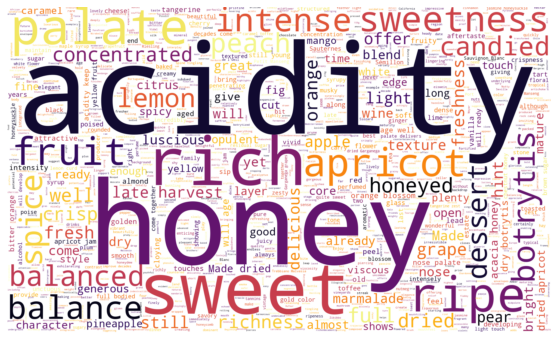

In [80]:
#WordCloud for dessert
wc = WordCloud(stopwords=stopwords,background_color="white", max_words=2000, width=1000, height=600,colormap = plt.cm.inferno, scale = 2.0)
wc.generate(' '.join(DessertWC['wine_description']))
plt.figure(figsize=(12, 6))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

In [81]:
RoseWC = data[data['wine_category'] == 'Rose']
RoseWC

,Unnamed: 0,wine_alcohol,wine_category,wine_description,wine_name,wine_origin,wine_point,wine_price,wine_variety
259,263,11.70,Rose,"Bright bubblegum, wet stone and chalk aromas a...",Thacher 2018 Rosé of Cinsault (Central Coast),US,92,28,Cinsault
310,315,12.00,Rose,From a domaine on the eastern coast of Corsica...,Domaine Santa Giuletta 2016 Rosé (Corse),France,88,19,Rosé
311,316,12.50,Rose,This warm fruity wine is rounded and ripe with...,Jérôme Gueneau 2016 Domaine des Grandes Perriè...,France,88,24,Rosé
320,325,11.50,Rose,"While dry in style and subtle on the nose, thi...",Villa Wolf 2016 Pinot Noir Rosé (Pfalz),Germany,89,12,Rosé
321,326,14.20,Rose,"One of the more substantial examples of rosé, ...",Tinto Rey 2016 Rosé (Dunnigan Hills),US,89,16,Rosé
342,347,14.20,Rose,"This is a rich, spicy and lush-fruited rosé. I...",Aubichon Cellars 2016 Vin Rosé de Pinot Gris (...,US,90,25,Pinot Gris
347,352,13.60,Rose,"Zippy upon opening and even a day later, this ...",Presqu'ile 2016 Rosé of Pinot Noir (Santa Mari...,US,90,22,Pinot Noir
395,402,13.00,Rose,This 95% Grenache rosé is a pale salmon hue. S...,Turkey Flat 2016 Rosé (Barossa Valley),Australia,89,20,Rosé
419,428,31.00,Rose,This pale copper rosé blends 71% Shiraz with 1...,Fairbank Sutton Grange 2016 Rosé (Bendigo),Australia,89,22,Rosé
426,435,13.50,Rose,"This is nice, firm and dry, with lightly tangy...",Adelsheim 2016 Rosé (Willamette Valley),US,89,25,Rosé


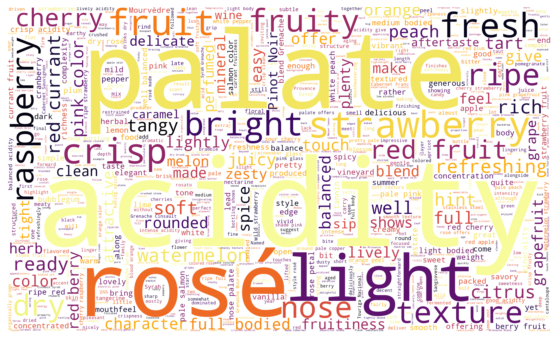

In [82]:
#WordCloud for Rose
wc = WordCloud(stopwords=stopwords,background_color="white", max_words=2000, width=1000, height=600,colormap = plt.cm.inferno, scale = 2.0)
wc.generate(' '.join(RoseWC['wine_description']))
plt.figure(figsize=(12, 6))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

In [83]:
PortWC = data[data['wine_category'] == 'Port/Sherry']
PortWC

,Unnamed: 0,wine_alcohol,wine_category,wine_description,wine_name,wine_origin,wine_point,wine_price,wine_variety
38,40,20.0,Port/Sherry,The structure of this wine is dense in tannins...,Quinta do Vesuvio 2017 Port,Portugal,96,95,Port
49,51,20.0,Port/Sherry,Rich tannins are balanced by the ripe blackber...,W. & J. Graham's 2017 The Stone Terraces (Port),Portugal,98,240,Port
51,53,20.0,Port/Sherry,"This is a magnificent, opulent wine, with rich...",Taylor Fladgate 2017 Vargellas Vinhas Velhas ...,Portugal,100,250,Port
52,54,20.5,Port/Sherry,"This is going to be a major, impressive wine. ...",Sandeman 2017 Quinta do Seixo (Port),Portugal,100,70,Port
58,60,20.0,Port/Sherry,"A beautifully juicy wine, packed with firm tan...",Croft 2017 Serikos Vintage (Port),Portugal,95,225,Port
67,69,19.5,Port/Sherry,"Ripe with succulent black fruits, this wine is...",Quinta do Vale Meão 2017 Port,Portugal,96,89,Port
68,70,20.5,Port/Sherry,This wine's opulent intensity comes from the p...,Cockburn's 2017 Port,Portugal,96,95,Port
313,318,20.0,Port/Sherry,Passion-fruit aromas are mingled with a strong...,Duorum 2015 Vintage (Port),Portugal,88,90,Port
423,432,20.0,Port/Sherry,"The structure is the thing with this wine, giv...",Cálem 2015 Vintage (Port),Portugal,89,40,Port
460,473,20.0,Port/Sherry,This LBV Port is powered by jammy damson and p...,Delaforce 2011 Late Bottled Vintage (Port),Portugal,89,20,Port


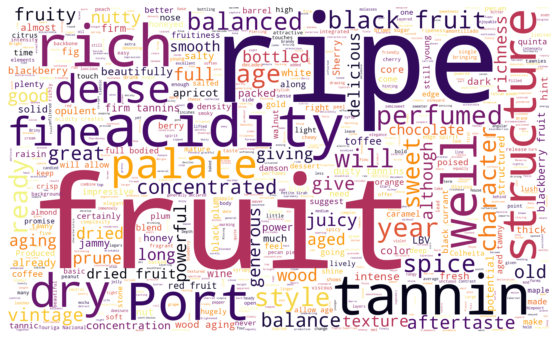

In [84]:
#WordCloud for Port/Sherry
wc = WordCloud(stopwords=stopwords,background_color="white", max_words=2000, width=1000, height=600,colormap = plt.cm.inferno, scale = 2.0)
wc.generate(' '.join(PortWC['wine_description']))
plt.figure(figsize=(12, 6))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

In [85]:
data.loc[data['wine_category'] == 'Port/Sherry']

,Unnamed: 0,wine_alcohol,wine_category,wine_description,wine_name,wine_origin,wine_point,wine_price,wine_variety
38,40,20.0,Port/Sherry,The structure of this wine is dense in tannins...,Quinta do Vesuvio 2017 Port,Portugal,96,95,Port
49,51,20.0,Port/Sherry,Rich tannins are balanced by the ripe blackber...,W. & J. Graham's 2017 The Stone Terraces (Port),Portugal,98,240,Port
51,53,20.0,Port/Sherry,"This is a magnificent, opulent wine, with rich...",Taylor Fladgate 2017 Vargellas Vinhas Velhas ...,Portugal,100,250,Port
52,54,20.5,Port/Sherry,"This is going to be a major, impressive wine. ...",Sandeman 2017 Quinta do Seixo (Port),Portugal,100,70,Port
58,60,20.0,Port/Sherry,"A beautifully juicy wine, packed with firm tan...",Croft 2017 Serikos Vintage (Port),Portugal,95,225,Port
67,69,19.5,Port/Sherry,"Ripe with succulent black fruits, this wine is...",Quinta do Vale Meão 2017 Port,Portugal,96,89,Port
68,70,20.5,Port/Sherry,This wine's opulent intensity comes from the p...,Cockburn's 2017 Port,Portugal,96,95,Port
313,318,20.0,Port/Sherry,Passion-fruit aromas are mingled with a strong...,Duorum 2015 Vintage (Port),Portugal,88,90,Port
423,432,20.0,Port/Sherry,"The structure is the thing with this wine, giv...",Cálem 2015 Vintage (Port),Portugal,89,40,Port
460,473,20.0,Port/Sherry,This LBV Port is powered by jammy damson and p...,Delaforce 2011 Late Bottled Vintage (Port),Portugal,89,20,Port
